# Statistical Modelling Exercise

# Task 1- Maximum Likelihood Inference

## Loading 'Quiet Don' dataset into Pandas

In [1]:
import pandas as pd

df = pd.read_csv('COMM054Dataset\QuietDonSentenceLengths.csv')
df.head()

,6
0,25
1,12
2,10
3,16
4,5


### Data exploration with Seaborn Bar Chart

Transposing the rows to columns, allowing to plot a bar chart of the dataset and illustrate its distribution.

In [2]:
import seaborn as sns

barplt = df.transpose()

<AxesSubplot:>

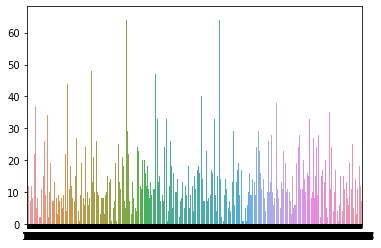

In [6]:
sns.barplot(data=barplt)

## Fitting data to a Poisson Distribution 

Parsing the dataframe into the model with an array of *ones* with the same shape as the dataframe. Finally, printing *Mu* calculated from the model and the overall model summary.

In [4]:
import scipy.stats
import numpy as np
import statsmodels.api as sm
from statsmodels.api import Poisson

X = np.ones_like(df)
pdres = sm.Poisson(df,X).fit()
mu =  np.mean(df['6'])

print("mean: ", np.mean(df['6']))
print("mu: ", np.exp(pdres.params))
print(pdres.summary())

C:\Users\Matthew\Anaconda3\lib\site-packages\statsmodels\tools\_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


Optimization terminated successfully.
         Current function value: 4.947704
         Iterations 1
mean:  12.674913540835329
mu:  const    12.674914
dtype: float64
                          Poisson Regression Results                          
Dep. Variable:                      6   No. Observations:                 3759
Model:                        Poisson   Df Residuals:                     3758
Method:                           MLE   Df Model:                            0
Date:                Tue, 08 Jun 2021   Pseudo R-squ.:                   0.000
Time:                        04:53:35   Log-Likelihood:                -18598.
converged:                       True   LL-Null:                       -18598.
Covariance Type:            nonrobust   LLR p-value:                       nan
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          2.5396      0.005    554.343

## Fitting data to a Negative Binomial Distribution

In a similar way to the Poisson Distribution implementation, fitting the Negative Binomial uses the same dataframe and *X* array and prints the model summary.

In [91]:
from statsmodels.discrete.discrete_model import NegativeBinomial

nbdres = sm.NegativeBinomial(df, X).fit()

print(nbdres.summary())
print("exp: ", np.exp(nbdres.params))

Optimization terminated successfully.
         Current function value: 3.418018
         Iterations: 4
         Function evaluations: 5
         Gradient evaluations: 5
                     NegativeBinomial Regression Results                      
Dep. Variable:                      6   No. Observations:                 3759
Model:               NegativeBinomial   Df Residuals:                     3758
Method:                           MLE   Df Model:                            0
Date:                Wed, 02 Jun 2021   Pseudo R-squ.:               8.507e-12
Time:                        05:25:49   Log-Likelihood:                -12848.
converged:                       True   LL-Null:                       -12848.
Covariance Type:            nonrobust   LLR p-value:                       nan
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          2.5396      0.011    230.9

## The Key Concepts and Implementation of Maximum Likelihood Inference and Model Evaluations 

**Maximum Likelihood Inference** is a method which dictate values for *parameters* of a model. It is a method which maximises the *likelihood* that a operation carried out by the chosen model constructs the data that was *observed*.

Within the code implemented, `fit(data)` is the method used to:
> *"Return MLEs for shape (if applicable), location, and scale parameters from data."* 

>(*Taken from:* https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.rv_continuous.fit.html#scipy.stats.rv_continuous.fit)


### How well the the two distributions fit the data



Looking at the two models, we can see that Poisson fits the data better around the mean as the standard error is **0.005** for Poisson in comparison to **0.011** for the Negative Binomial model. We can see that both of these models are very similar in their modelling in the outer bounds with *0.025* at **2.531** and **2.518** for the Poisson and Negative Binomial distributions respectively; following with *0.975* at **2.549** and **2.561** for both distributions.

<AxesSubplot:>

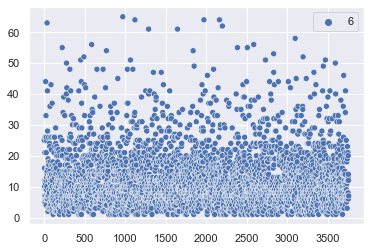

In [34]:
sns.scatterplot(data=df)

#### Plotting Probability Mass Functon of Poisson Distribution

Adapted from the *Week 5 Lab Session* to plot the **probabilty mass function** of the Poisson Distribution using the value of *Mu*.

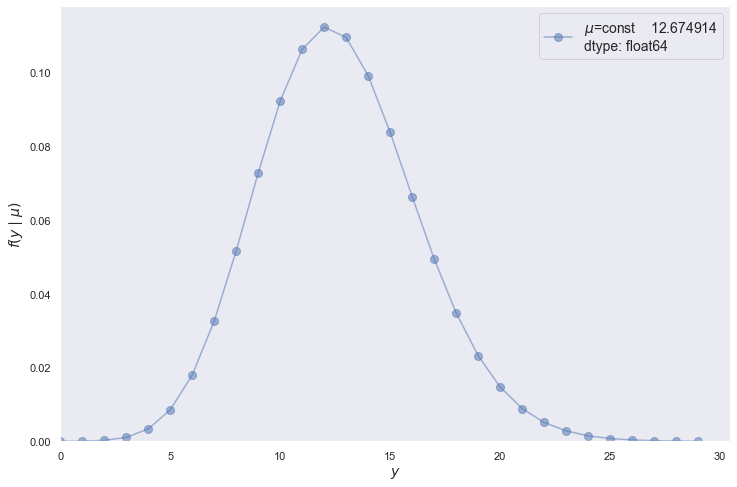

In [23]:
from matplotlib import pyplot as plt
from scipy.stats import poisson
import scipy.stats

y_values = range(0, 30)

fig, ax = plt.subplots(figsize=(12, 8))

for mu in [np.exp(pdres.params)]:
    distribution = []
    for y_i in y_values:
        distribution.append(poisson(mu).pmf(y_i))
    ax.plot(y_values,
        distribution,
        label=f'$\mu$={mu}',
        alpha=0.5,
        marker='o',
        markersize=8)
    
ax.grid()
ax.set_xlabel('$y$', fontsize=14)
ax.set_ylabel('$f(y \mid \mu)$', fontsize=14)
ax.axis(xmin=0, ymin=0)
ax.legend(fontsize=14)

plt.show()

## Key Concepts of MAP Estimation and its differences to MLE 

**Maximum a Posteriori Estimation** attempts to maximise the *posterior probability* and generates a single parameter estimate using posterior distribution. 

In essence, it is very similar to MLE, however differs in that it maximises the posterior rather than the likelihood. Moreover, if the prior is uniform, it means that maximum likelihood inference and MAP inference are equivalent.

## Poisson Distribution using MAP Estimation

Constructing the gamma distribution with shape *4*, scale *0.1* and plotting it.

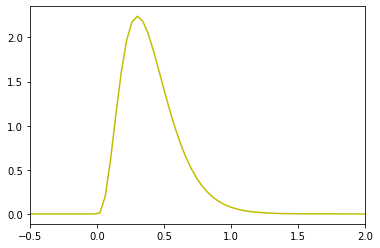

In [43]:
from scipy.stats import gamma
import scipy.stats as stats 
prior_sd = 0.1
prior_mean = 0
mus = np.linspace(-20, 20, 1000) 
ys = stats.gamma.pdf(mus, a=4, scale=prior_sd)

plt.plot(mus, ys, "y-", label=(r'$\alpha=a, \beta=10$')) 
plt.xlim([-0.5,2])
plt.show()

Setting prior to the constructed gamma distribution.

In [230]:
prior = lambda x: stats.gamma.pdf(mus, a=4, scale=prior_sd)

In [237]:
def nlposterior(mu):
    loglikelihood_array = stats.gamma.logpdf(x,loc=mu,scale=1.0,a=4)
    loglikelihood = np.sum(loglikelihood_array)
    prior = gamma.logpdf(mu,loc=prior_mean,scale=prior_sd,a=4)
    return -(loglikelihood+prior)

# Task 2 - Classification and Validation

## Naïve Bayes and Logistic Regression

### How Naïve Bayes and Logistic Regression work 

Naïve Bayes works on the basis of classification. The goal of this method is to assign each data point to a *class c* based on its properties. We do this by using the *prior* probability of a data point belonging to class *k* and the *likelihood* of the data point *i assuming that it belongs to class k*. Naïve Bayes works on the assumption that there is independence among its predictors. 

For *y* output, two possibilites can occur during classification called *binary classification* or *multiclass classification*. It may be that *y* is equal to either **0 or 1**. Alternatively, *y* may take **multiple possible values**. However, for any given input, the ouput **can only take one value**.

In the case of document classification, we identify a class for each document based solely on the text contained within it, we assume that the document can be modelled using **bag of words**. 

Logistic Regression is interested in modelling the probabilty of a success for the covariate value. We are performing a linear regression, however applying a sigmoid function for the output. Assumptions made by the Logistic Regression model is that each observation must be independent of each other and assumes linearity of independent variables and log odds.

## Loading ATLAS Dataset

In [5]:
X = np.loadtxt('COMM054Dataset\ATLAS-data.csv',delimiter=',')
labels = np.loadtxt('COMM054Dataset\ATLAS-labels.csv',delimiter=',')

atlas_data = pd.read_csv('COMM054Dataset\ATLAS-data.csv')
atlas_labels = pd.read_csv('COMM054Dataset\ATLAS-labels.csv')

atlas_data.head()

,243.128,96.455,158.618,90.253,0.693,56.238,1.581,3.615,13.597,264.586,...,72.877,2.121,376.41,46.248,-0.958,-0.444,42.759,-1.651,-1.445,157.638
0,139.751,74.028,111.619,44.266,2.119,104.723,-0.498,2.533,9.437,168.638,...,20.147,0.447,252.698,36.798,0.269,-1.254,31.816,-1.849,0.664,68.614
1,116.217,73.136,59.239,101.850,0.625,85.539,2.979,1.922,28.049,202.636,...,68.144,1.816,271.485,82.453,2.066,-1.210,58.216,1.442,-2.288,140.669
2,64.544,0.099,28.945,341.418,2.390,358.936,-1.181,0.714,35.293,508.349,...,243.099,-2.409,470.806,331.152,-1.693,0.615,41.742,0.697,1.083,409.977
3,32.281,67.393,26.006,29.088,1.330,108.191,-0.362,0.846,48.389,152.087,...,32.186,-1.421,244.220,48.198,0.949,1.517,40.382,-0.382,-2.029,88.580
4,135.018,97.900,106.636,77.614,2.530,239.596,-1.207,2.698,66.300,320.620,...,21.931,1.605,257.142,96.266,0.638,2.543,45.109,-1.892,-1.956,184.771


In [147]:
atlas_labels.head()

,0
0,0
1,0
2,0
3,0
4,1


Finding out how *balanced* the datasets columns are.

In [50]:
atlas_labels.value_counts()

0
0    5311
1    4688
dtype: int64

In [70]:
print("Proportion of label '0' in dataset: "+ str(atlas_labels.value_counts().tolist()[0]/(atlas_labels.value_counts().tolist()[0]+atlas_labels.value_counts().tolist()[1])))
print("Proportion of label '1' in dataset: "+ str(atlas_labels.value_counts().tolist()[1]/(atlas_labels.value_counts().tolist()[0]+atlas_labels.value_counts().tolist()[1])))

Proportion of label '0' in dataset: 0.5311531153115312
Proportion of label '1' in dataset: 0.46884688468846886


Overall dataset chart matrix, finding insights such as correlation between columns.

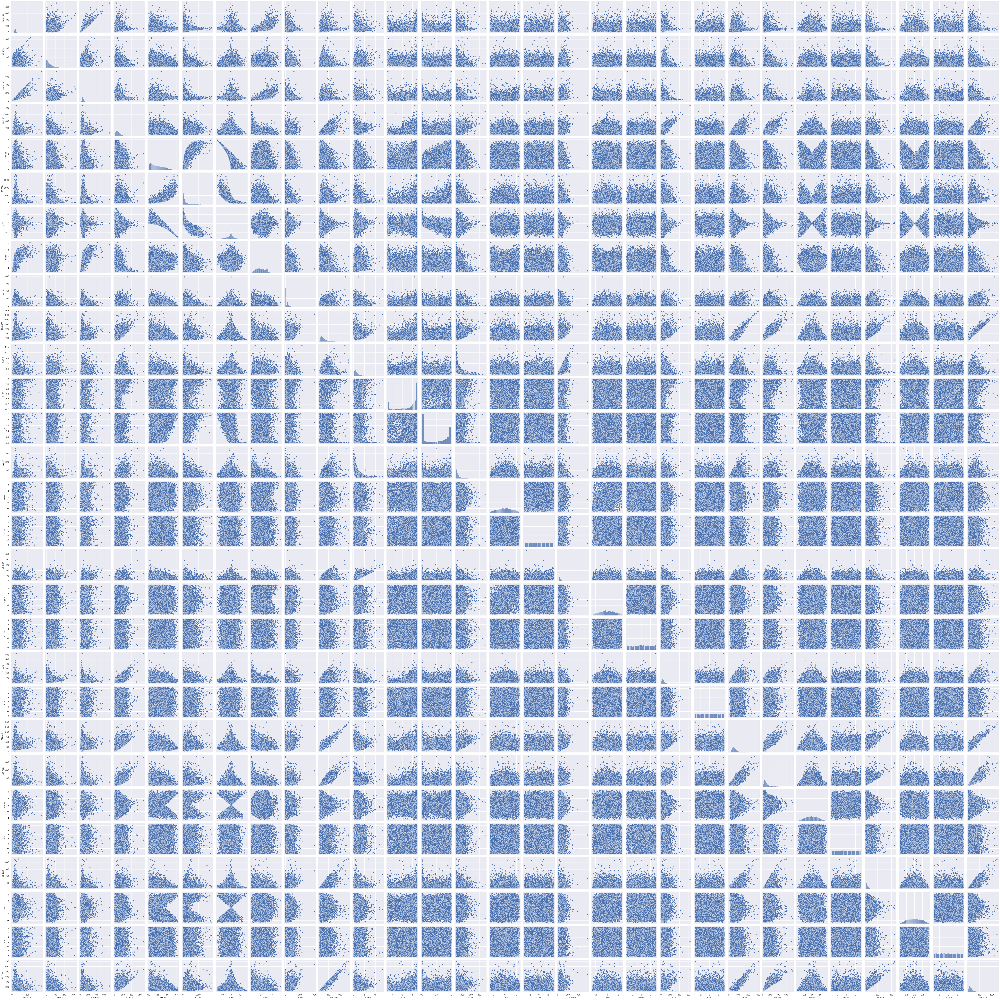

In [111]:
sns.pairplot(atlas_data)

## Fitting the Naïve Bayes Model

Splitting the dataset into training and testing, *30%* of the dataset will be partitioned to evaluate the model and *70%* will be used to train the model.

In [73]:
import sklearn
from sklearn.datasets import make_blobs
from sklearn.preprocessing import scale
from sklearn.naive_bayes import GaussianNB
from sklearn.cross_validation import train_test_split

X_scaled = sklearn.preprocessing.scale(X)

X_train, X_test, y_train, y_test = train_test_split(X_scaled, labels, test_size=0.3,random_state=109)

Calling the Naïve Bayes and parsing the training dataset with the training labels. Further, calling the predict method to predict the labels associated with the partitioned testing dataset and storing the results in *y_pred*.

In [74]:
nbclassifier = GaussianNB()
nbclassifier.fit(X_train,y_train)

y_pred = nbclassifier.predict(X_test)

### Evaluating the Model

Creating a confusion matrix to visualise the performance of the model on the testing dataset. We see the number of correctly predicted values for each label.

Text(0.5, 257.44, 'Predicted label')

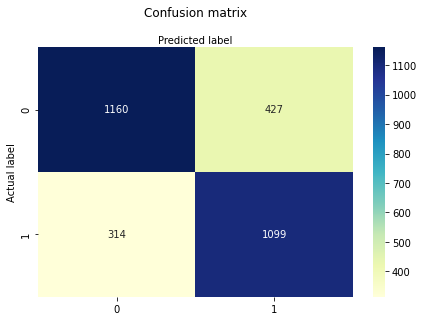

In [84]:
from sklearn.metrics import confusion_matrix

cnf_matrix_nb = metrics.confusion_matrix(y_test, y_pred)
cnf_matrix_nb

class_names=[0,1]
fig, ax = plt.subplots()
tick_marks = np.arange(len(class_names))
plt.xticks(tick_marks, class_names)
plt.yticks(tick_marks, class_names)

# create heatmap
sns.heatmap(pd.DataFrame(cnf_matrix_nb), annot=True, cmap="YlGnBu" ,fmt='g')
ax.xaxis.set_label_position("top")
plt.tight_layout()
plt.title('Confusion matrix', y=1.1)
plt.ylabel('Actual label')
plt.xlabel('Predicted label')

Calculating the accuracy of the model in regards to the two labels: *0* and *1*.

In [86]:
cnf_matrix_nb_n = cnf_matrix_nb.astype('float') / cnf_matrix_nb.sum(axis=1)[:, np.newaxis]
cnf_matrix_nb_n.diagonal()

array([0.73093888, 0.77777778])

Using *Accuracy*, *Precision* and *Recall* to evaluate the performance of the model.

In [76]:
from sklearn import metrics

print("Accuracy:",metrics.accuracy_score(y_test, y_pred))
print("Precision:",metrics.precision_score(y_test, y_pred))
print("Recall:",metrics.recall_score(y_test, y_pred))

Accuracy: 0.753
Precision: 0.7201834862385321
Recall: 0.7777777777777778


Further evaluating the model using the *F-1 Score* taking into account both precision and recall.

In [77]:
from sklearn.metrics import f1_score

f1_score(y_test,y_pred)

0.7478734263354883

## Fitting the Logistic Regression Model

Training the model with the datasets labels and data.

In [78]:
from sklearn.linear_model import LogisticRegression

logreg = LogisticRegression()
logreg.fit(X_train,y_train)

LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
          intercept_scaling=1, max_iter=100, multi_class='ovr', n_jobs=1,
          penalty='l2', random_state=None, solver='liblinear', tol=0.0001,
          verbose=0, warm_start=False)

In a similar way to the Naïve Bayes model, we use the model to predict the labels associated with *X_test* and assign the predictions to variable *ly_pred*. 

In [79]:
ly_pred = logreg.predict(X_test)

### Evaluating the Model

Using a confusion matrix, we can determine the performance of the model in predicting the dataset labels.

In [80]:
cnf_matrix_lr = metrics.confusion_matrix(y_test, ly_pred)
cnf_matrix_lr

array([[1241,  346],
       [ 435,  978]], dtype=int64)

Text(0.5, 257.44, 'Predicted label')

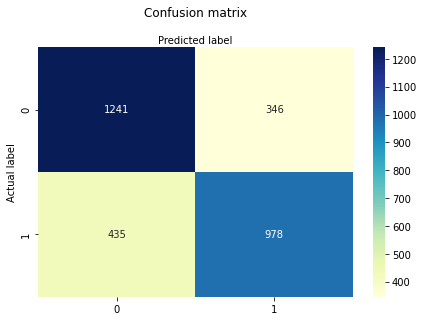

In [81]:
class_names=[0,1] 
fig, ax = plt.subplots()
tick_marks = np.arange(len(class_names))
plt.xticks(tick_marks, class_names)
plt.yticks(tick_marks, class_names)
# create heatmap
sns.heatmap(pd.DataFrame(cnf_matrix_lr), annot=True, cmap="YlGnBu" ,fmt='g')
ax.xaxis.set_label_position("top")
plt.tight_layout()
plt.title('Confusion matrix', y=1.1)
plt.ylabel('Actual label')
plt.xlabel('Predicted label')

Calculating the accuracy of the model in regards to the two labels: *0* and *1*.

In [87]:
cnf_matrix_lr_n = cnf_matrix_lr.astype('float') / cnf_matrix_lr.sum(axis=1)[:, np.newaxis]
cnf_matrix_lr_n.diagonal()

array([0.78197858, 0.69214437])

Evaluating the model through mutiple metric scores.

In [143]:
print("Accuracy:",metrics.accuracy_score(y_test, ly_pred))
print("Precision:",metrics.precision_score(y_test, ly_pred))
print("Recall:",metrics.recall_score(y_test, ly_pred))

Accuracy: 0.7396666666666667
Precision: 0.7386706948640483
Recall: 0.692144373673036


In [144]:
f1_score(y_test,ly_pred)

0.7146510778224333

## Comparing the Models 

Comparing the Naïve Bayes model and the Logistic Regression model, we can see very similar performances. Evaluting the models through *F-1 scores*, we see values **0.7478** and **0.7147** for both Naïve Bayes and Logistic Regression respectively. In this way, Naïve Bayes is a narrowly better model by a score of roughly **0.3**.

Further evaluation reinforces these findings, as overall accuracy is less within Logistic Regression compared to Naïve Bayes with **0.740** and **0.753**; with accuracies of **0.7820** and **0.6921** for the labels of *0* and *1* for Logistic Regression compared to **0.7310** and **0.7778** of Naïve Bayes. A difference of roughly **8.57%** in accuracy when predicting the label *1*.

We can therefore conclude, that Naïve Bayes is the superior model in comparison to Logistic Regression when handling classification of this dataset.

In [13]:
%matplotlib notebook

<IPython.core.display.Javascript object>


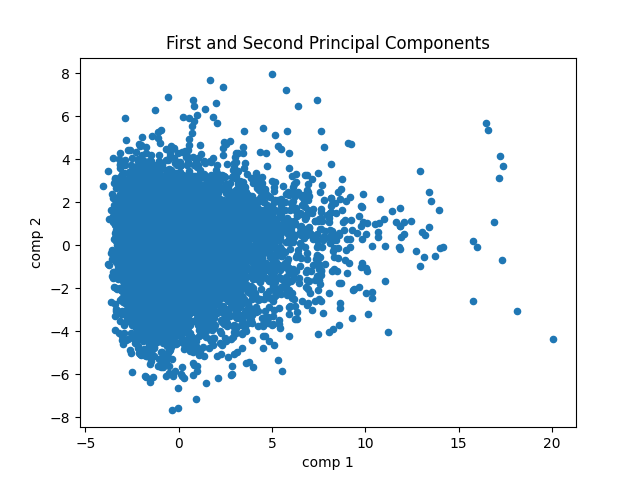

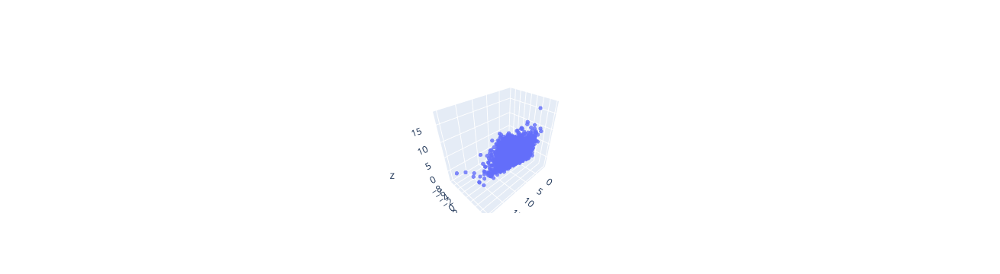

In [16]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

bigboi = pd.DataFrame()
bigboi = atlas_data


scale = StandardScaler()
dat = scale.fit_transform(bigboi)
pca = PCA(n_components = 3)
comps = pca.fit_transform(dat)

PCAout = pd.DataFrame(comps, columns=["comp 1","comp 2","comp 3"])
PCAout.plot(x="comp 1", y="comp 2", kind='scatter', legend=False, title='First and Second Principal Components')

import plotly.graph_objects as go

marker_data = go.Scatter3d(
    x=PCAout['comp 1'], 
    y=PCAout['comp 2'], 
    z=PCAout['comp 3'], 
    marker=go.scatter3d.Marker(size=3), 
    opacity=0.8, 
    mode='markers'
)
fig=go.Figure(data=marker_data)
fig.show()